# Optimal EV charging Locations 

The global climate crisis has intensified the urgency to transition to sustainable and eco-friendly transportation solutions. Electric vehicles (EVs) are widely recognized as a promising alternative to traditional fossil fuel-powered vehicles, offering reduced greenhouse gas emissions and lower environmental impact. However, the widespread adoption of EVs requires a robust charging infrastructure that ensures convenient and reliable access to charging stations for EV owners. Dublin, being a significant urban center with a growing number of EV users, faces the pressing need to establish an optimal network of charging stations to support the transition towards clean and green mobility.

To address this challenge, we embark on a data-driven approach to identify the optimal locations for new EV charging stations in Dublin. By leveraging various geospatial datasets and employing optimization algorithms, we aim to strategically place charging stations to maximize accessibility, economic viability, and environmental benefits.





## OpenStreetMap API

OpenStreetMap (OSM) is a collaborative and open-source mapping project that aims to create a free, editable, and detailed map of the entire world. Unlike traditional mapping services that are usually proprietary and controlled by specific companies, OpenStreetMap allows individuals and communities worldwide to contribute and edit geographical data, making it a truly democratic and community-driven endeavor.

Launched in 2004, OpenStreetMap has grown into a vast and constantly expanding database of geographic information, covering everything from roads, streets, and buildings to rivers, parks, and natural features. Volunteers, known as contributors, use GPS devices, aerial imagery, and local knowledge to trace and add data to the map, ensuring its accuracy and up-to-dateness.


## OpenChargeMap API

OpenChargeMap (OCM) is a collaborative and open-source project that aims to create a comprehensive and up-to-date map of electric vehicle (EV) charging stations worldwide. Similar to OpenStreetMap, OpenChargeMap adopts an open and community-driven approach, allowing individuals and organizations to contribute and edit information related to EV charging infrastructure.

Launched to address the growing demand for accurate and accessible EV charging data, OpenChargeMap provides a platform for EV enthusiasts, charging station operators, and other stakeholders to share information about charging locations, available connectors, charging speeds, and other relevant details. By pooling together contributions from a diverse range of sources, OpenChargeMap aims to create a global resource that helps EV drivers find and access charging facilities with ease.

Volunteers, known as contributors, play a crucial role in keeping OpenChargeMap current and reliable. They can add new charging stations, update existing information, and verify the accuracy of data through on-site visits or through trusted sources. This collaborative effort ensures that the map remains up-to-date and useful for the growing community of electric vehicle users worldwide.



.

.

In [1]:
import osmnx as ox
import pandas as pd
import folium
import requests
import matplotlib.pyplot as plt
import seaborn as sns
from shapely.geometry import Point, Polygon, MultiPolygon, shape
import plotly.express as px
import plotly.offline as pyo
import pyproj
import geopandas as gpd
import warnings

# Set up Plotly to work in offline mode
pyo.init_notebook_mode(connected=True)

In [2]:
# Get the coordinates for Dublin, Ireland
location = ox.geocode('Dublin, Ireland')

In [3]:
print("The coordinates for Dublin city centre is", location)

The coordinates for Dublin city centre is (53.3493795, -6.2605593)


# Number of EV charging locations in Banglore

In [144]:
location_in = ox.geocode('Banglore,India')
def get_charging_stations(latitude, longitude, radius, api_key):
    url = f"https://api.openchargemap.io/v3/poi/?output=json&latitude={latitude}&longitude={longitude}&distance={radius}&distanceunit=KM&maxresults=300&&verbose=false&key={api_key}"
    
    try:
        response = requests.get(url)
        response.raise_for_status()
        data = response.json()
        return data

    except requests.exceptions.RequestException as e:
        print("Error occurred while retrieving charging station data:", e)
        return None
    except ValueError as e:
        print("Error occurred while parsing JSON response:", e)
        return None

# Dublin Center coordinates
latitude = location_in[0]
longitude = location_in[1]

# Radius in kilometers
radius = 25

# API key from OpenChargeMap
api_key = "431e2548-cd50-4959-971b-5e99539c2651"

charging_stations = get_charging_stations(latitude, longitude, radius, api_key)
charging_stations = pd.DataFrame(charging_stations)
print("Number of charging locations: ",len(charging_stations))

Number of charging locations:  5


# Hotspot Locations in Dublin

Here we identify potential hotspot locations in Dublin where new electric vehicle (EV) charging stations can be established. To achieve this, we leverage OpenStreetMap (OSM) API to get all the hotspots within a 20 Km radius from the centre of Dublin and then keep only those locations that satisfy our conditions.

These hotspots serve as the foundational dataset for our subsequent optimization process, where we aim to identify the optimal charging station locations from this pool of potential sites. Our ultimate goal is to ensure that the selected charging station locations not only cater to the current demand but also accommodate the projected growth in EV adoption, contributing to the sustainable and efficient electrification of transportation in Dublin. 

In [4]:
# Use OpenStreetMaps library to get all the hotspots within a specified distance
distance = 20000  # Radius of 20 kilometers around the location
tags = {'amenity': True}
gdf = ox.geometries_from_point(location, tags=tags, dist=distance)

C:\Users\ishan\AppData\Local\Temp\ipykernel_12432\4114702718.py:4: UserWarning:

The `geometries` module and `geometries_from_X` functions have been renamed the `features` module and `features_from_X` functions. Use these instead. The `geometries` module and function names are deprecated and will be removed in a future release.



In [5]:
gdf.head()

barrier bicycle foot horse motorcar motorcycle  \
element_type osmid                                                     
node         12244654     NaN     NaN  NaN   NaN      NaN        NaN   
             26452895     NaN     NaN  NaN   NaN      NaN        NaN   
             27474191     NaN     NaN  NaN   NaN      NaN        NaN   
             27474239     NaN     NaN  NaN   NaN      NaN        NaN   
             28851055     NaN     NaN  NaN   NaN      NaN        NaN   

                                        geometry            addr:street  \
element_type osmid                                                        
node         12244654  POINT (-6.41780 53.38335)         Clonsilla Road   
             26452895  POINT (-6.40512 53.37260)                    NaN   
             27474191  POINT (-6.39116 53.39073)  Blanchardstown Centre   
             27474239  POINT (-6.39183 53.39096)                    NaN   
             28851055  POINT (-6.30699 53.39947)             North Road   

                                amenity       brand  ... truck_wash heating  \
element_type osmid                                   ...                      
node         12244654              fuel  Applegreen  ...        NaN     NaN   
             26452895  parking_entrance         NaN  ...        NaN     NaN   
             27474191           library         NaN  ...        NaN     NaN   
             27474239           theatre         NaN  ...        NaN     NaN   
             28851055              fuel    Circle K  ...        NaN     NaN   

                      website:en access:conditional access:note  \
element_type osmid                                                
node         12244654        NaN                NaN         NaN   
             26452895        NaN                NaN         NaN   
             27474191        NaN                NaN         NaN   
             27474239        NaN                NaN         NaN   
             28851055        NaN                NaN         NaN   

                      recycling:small_electrical_appliances  \
element_type osmid                                            
node         12244654                                   NaN   
             26452895                                   NaN   
             27474191                                   NaN   
             27474239                                   NaN   
             28851055                                   NaN   

                      recycling:tetrapak recycling:textiles ways fee:covid19  
element_type osmid                                                            
node         12244654                NaN                NaN  NaN         NaN  
             26452895                NaN                NaN  NaN         NaN  
             27474191                NaN                NaN  NaN         NaN  
             27474239                NaN                NaN  NaN         NaN  
             28851055                NaN                NaN  NaN         NaN  

[5 rows x 661 columns]

In [6]:
gdf.shape

(32306, 661)

In [7]:
gdf['amenity'].unique()

array(['fuel', 'parking_entrance', 'library', 'theatre', 'parking',
       'restaurant', 'recycling', 'post_office', 'post_box', 'atm', 'pub',
       'vending_machine', 'post_depot', 'fast_food', 'pharmacy', 'police',
       'nursing_home', 'telephone', 'waste_basket', 'toilets', 'bank',
       'taxi', 'cinema', 'social_facility', 'place_of_worship',
       'community_centre', 'bicycle_parking', 'fountain', 'nightclub',
       'cafe', 'arts_centre', 'bar', 'drinking_water', 'events_venue',
       'kindergarten', 'childcare', 'coast_guard', 'bench', 'veterinary',
       'dentist', 'shelter', 'waste_disposal', 'clock', 'bicycle_rental',
       'marketplace', 'college', 'car_wash', 'car_rental', 'studio',
       'doctors', 'driving_school', 'school', 'internet_cafe', 'casino',
       'ferry_terminal', 'ice_cream', 'research_institute', 'clinic',
       'weighbridge', 'ticket_validator', 'parking_space',
       'internet_access', 'hospital', 'charging_station', 'bbq',
       'car_sharing',

Considering the lack of data regarding the cost and availability of space for new charging stations, we opted for a conservative approach in selecting potential locations. We focused on choosing spots where we can guarantee sufficient space for a new charging station while also being cost-effective. By targeting areas with guaranteed space, the cost of acquiring the necessary area for constructing a new station is expected to be relatively low. Additionally, these locations are chosen in a way that minimizes potential disruption to traffic and daily activities in the area, ensuring a smooth integration of the charging stations into the existing infrastructure. This approach strikes a balance between practicality and economic viability, providing a foundation for successful implementation of the charging station network.

Based on looking at the list of available tags above, we finalized on the following sets as they satisfy our criteria:

In [8]:
hotspot_tags = ['fuel', 'parking', 'events_venue', 'college', 'hospital', 
                'university', 'food_court', 'exhibition_centre', 'townhall', 'stadium', 'conference_centre']

In [9]:
# Filter the data for the hotspots in the same 25 Km radius
hotspots = gdf[gdf['amenity'].isin(hotspot_tags)]

In [10]:
hotspots.shape

(7234, 661)

In [11]:
hotspots = pd.DataFrame(hotspots)

# Remove all the columns which have less than 10% of the records populated
selected_columns = hotspots.columns[hotspots.count() > 0.1*len(hotspots)]
hotspots = hotspots[selected_columns]

In [12]:
hotspots.shape

(7234, 9)

In [13]:
hotspots.head()

geometry  amenity        name access  \
element_type osmid                                                             
node         12244654  POINT (-6.41780 53.38335)     fuel  Applegreen    NaN   
             28851055  POINT (-6.30699 53.39947)     fuel    Circle K    NaN   
             29403586  POINT (-6.29177 53.17470)  parking         NaN    yes   
             84881614  POINT (-6.24705 53.25363)  parking         NaN    NaN   
             88362015  POINT (-6.19803 53.48678)     fuel    Circle K    NaN   

                       fee  parking capacity surface nodes  
element_type osmid                                          
node         12244654  NaN      NaN      NaN     NaN   NaN  
             28851055  NaN      NaN      NaN     NaN   NaN  
             29403586   no  surface      NaN     NaN   NaN  
             84881614  NaN      NaN      NaN     NaN   NaN  
             88362015  NaN      NaN      NaN     NaN   NaN

In [14]:
# Creating separate columns for the latitude and longitude
hotspots['hotspot_latitude'] = hotspots['geometry'].apply(lambda point: point.y if isinstance(point, Point) else point.centroid.y)
hotspots['hotspot_longitude'] = hotspots['geometry'].apply(lambda point: point.x if isinstance(point, Point) else point.centroid.x)

In [15]:
# Pick only the features/columns which will be useful for our analysis 
hotspots_final = hotspots[['hotspot_latitude', 'hotspot_longitude', 'amenity', 'name']]

In [16]:
# Rename the column names for downstream use
hotspots_final = hotspots_final.rename(columns={'amenity': 'hotspot_tag', 
                                                'name': 'hotspot_location'})

In [17]:
print("The total number of potential hotspots considered for our analysis is", len(hotspots_final))

The total number of potential hotspots considered for our analysis is 7234


In [18]:
hotspots_final.reset_index(drop=True).head()

,hotspot_latitude,hotspot_longitude,hotspot_tag,hotspot_location
0,53.383351,-6.417798,fuel,Applegreen
1,53.399470,-6.306985,fuel,Circle K
2,53.174703,-6.291769,parking,NaN
3,53.253626,-6.247051,parking,NaN
4,53.486778,-6.198035,fuel,Circle K


In [19]:
# Get the counts of each hotspot category
category_counts = hotspots_final['hotspot_tag'].value_counts()

E:\Anaconda\lib\site-packages\seaborn\rcmod.py:400: DeprecationWarning:

distutils Version classes are deprecated. Use packaging.version instead.

E:\Anaconda\lib\site-packages\setuptools\_distutils\version.py:351: DeprecationWarning:

distutils Version classes are deprecated. Use packaging.version instead.



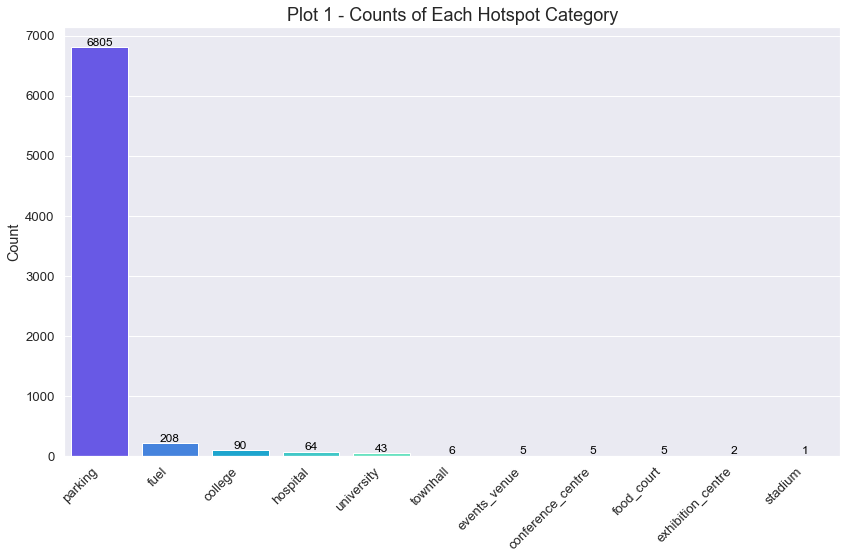

In [20]:
# Set the Seaborn style
sns.set(style='darkgrid', font_scale=1.2)

# Create a bar plot using Seaborn
plt.figure(figsize=(12, 8))
sns.barplot(x=category_counts.index, y=category_counts, palette='rainbow')

# Add count labels on top of each bar
for index, value in enumerate(category_counts):
    plt.text(index, value, str(value), ha='center', va='bottom', fontsize=12, color='black')

plt.ylabel('Count')
plt.title('Plot 1 - Counts of Each Hotspot Category', fontsize=18)
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

In [21]:
# Create a map centered around Dublin
latitude = location[0]  # Latitude of the center point
longitude = location[1] # Longitude of the center point
map_osm = folium.Map(location=[latitude, longitude], zoom_start=12)
# icon = folium.Icon(icon='circle', prefix='fa', color='blue', icon_color='white', icon_size=(4, 4))

# Add markers for each potential hotspot
for index, spot in hotspots_final.iterrows():
    name = spot['hotspot_location']
    lat = spot['hotspot_latitude']
    lon = spot['hotspot_longitude']
    marker = folium.CircleMarker(location=[lat, lon], radius=4, popup=name, color='green', fill=True, fill_color='green')
    marker.add_to(map_osm)

# Display the map
map_osm

/

# Existing Electric Vehicle Charging Station Locations in Dublin

Here, we obtain and analyze the existing electric vehicle (EV) charging station locations in Dublin. To achieve this, we leverage OpenChargeMap (OCM) API to get all the existing EV stations within a 25 Km radius from the centre of Dublin. The decision to extend the radius by an additional 5 km is deliberate and necessary. By considering this extra distance, we ensure that the EV charging hotspots near the outskirts of our primary 20 km radius (which is the focus of our hotspot analysis) are not unfairly excluded from our assessment. This precautionary measure allows us to map relevant features to the hotspots at the periphery of our 25 km radius, providing a comprehensive and accurate representation of all the hotspots under our consideration.

By compiling this data, we create a comprehensive dataset containing the latitude and longitude coordinates along with the charging characteristics of all the existing EV charging stations in Dublin. This dataset serves as a critical reference point for our subsequent analysis, enabling us to assess the proximity of potential hotspot locations to the existing charging infrastructure.

The information on existing charging station locations is instrumental in identifying areas with higher demand for charging stations and those with limited access to charging infrastructure. It helps us understand the coverage and gaps in the current charging network, guiding us in strategically placing new charging stations to enhance accessibility and promote widespread adoption of electric vehicles in Dublin.

In [22]:
def get_charging_stations(latitude, longitude, radius, api_key):
    url = f"https://api.openchargemap.io/v3/poi/?output=json&latitude={latitude}&longitude={longitude}&distance={radius}&distanceunit=KM&maxresults=300&&verbose=false&key={api_key}"
    
    try:
        response = requests.get(url)
        response.raise_for_status()
        data = response.json()
        return data

    except requests.exceptions.RequestException as e:
        print("Error occurred while retrieving charging station data:", e)
        return None
    except ValueError as e:
        print("Error occurred while parsing JSON response:", e)
        return None

# Dublin Center coordinates
latitude = location[0]
longitude = location[1]

# Radius in kilometers
radius = 25

# API key from OpenChargeMap
api_key = "431e2548-cd50-4959-971b-5e99539c2651"

charging_stations = get_charging_stations(latitude, longitude, radius, api_key)
charging_stations = pd.DataFrame(charging_stations)

In [23]:
len(charging_stations)

246

In [48]:
# Define a dictionary to map colors to categories
color_map = {
    'Type 1 (J1772)': 'orange',
    'Type 2 (Socket Only)': 'blue',
    'CCS (Type 2)': 'red',
    'Tesla (Model S/X)': 'green',
    'CHAdeMO': 'gray',
    'BS1363 3 Pin 13 Amp': 'purple',
    'Tesla Supercharger': 'darkgreen'
}

# Create a map centered around Dublin to display the EV charging points
map_osm = folium.Map(location=[latitude, longitude], zoom_start=12)

# Add markers for each charging station location with a different marker color for different charge type
for index, row in charging_stations_final.iterrows():
    name = row['Name'] + ', ' + str(row['PowerKW']) + ' Kw, ' + row['Title'] + ', ' + row['AddressLine1'] + ', ' + str(row['Town'])
    lon = row['Longitude']
    lat = row['Latitude']
    
    category = row['Name']
    marker_color = color_map.get(category, 'gray')  # Use 'gray' if category not found in the color map

    # marker = folium.Marker(location=[lat, lon], popup=name)
    # marker = folium.CircleMarker(location=[lat, lon], radius=5, color=marker_color, fill=True, fill_color=marker_color, fill_opacity=1, popup=name)
    icon = folium.Icon(color=marker_color, icon='map-marker')  # Use the 'map-marker' icon with the specified color

    marker = folium.Marker(location=[lat, lon], icon=icon, popup=name)

    marker.add_to(map_osm)

# Display the map
map_osm

.

# Public Service Spots in Dublin

This section focuses on identifying and mapping various public service locations within the city of Dublin. These public service spots may include essential facilities such as hospitals, police stations, fire stations, government offices, libraries, schools, and other civic amenities accessible to the general public. The availability and accessibility of public service spots are critical factors in urban planning and have a significant impact on the overall well-being and livability of the city.

In our bid to find optimal new electric vehicle charging station locations, the presence of these public service spots holds great importance. By considering their locations and proximity to potential charging stations, we can ensure that the new EV infrastructure complements and integrates seamlessly with the existing public services. This approach guarantees that electric vehicle users have easy access to both charging facilities and essential amenities, promoting sustainable urban mobility and contributing to a cleaner, greener city environment.

The rationale for using a 25 km radius applies here as well. This precautionary measure allows us to map relevant features to the hotspots at the periphery of our 20 km radius, providing a comprehensive and accurate representation of all the hotspots under our consideration.

In [49]:
distance = 25000  # Radius of 30 kilometers around the location
tags = {'amenity': True}
gdf = ox.geometries_from_point(location, tags=tags, dist=distance)

C:\Users\ishan\AppData\Local\Temp\ipykernel_12432\3329640468.py:3: UserWarning:

The `geometries` module and `geometries_from_X` functions have been renamed the `features` module and `features_from_X` functions. Use these instead. The `geometries` module and function names are deprecated and will be removed in a future release.



In [50]:
public_services_tags = ['school', 'pharmacy', 'place_of_worship', 'bank', 'doctors', 'kindergarten', 'social_facility', 
                        'post_office', 'clinic', 'childcare', 'library', 'police', 'veterinary', 'nursing_home', 'post_depot', 
                        'fire_station', 'courthouse']

In [51]:
# Filter the data for the public service spots in the same 25 km radius
public_services = gdf[gdf['amenity'].isin(public_services_tags)]

In [52]:
public_services.shape

(3190, 672)

In [53]:
public_services = pd.DataFrame(public_services)

# Remove all the columns which have less than 10% of the records populated
selected_columns = public_services.columns[public_services.count() > 0.1*len(public_services)]
public_services = public_services[selected_columns]

In [54]:
public_services.shape

(3190, 24)

In [55]:
public_services.head()

amenity                   geometry  \
element_type osmid                                                   
node         243783190           police  POINT (-6.35799 53.34473)   
             254952173         pharmacy  POINT (-6.42261 53.34785)   
             263367948  social_facility  POINT (-6.42324 53.34895)   
             278018000      post_office  POINT (-6.31741 53.28286)   
             278290761         pharmacy  POINT (-6.31806 53.28300)   

                              operator operator:wikidata operator:wikipedia  \
element_type osmid                                                            
node         243783190  Garda Síochána          Q1366959  en:Garda Síochána   
             254952173             NaN               NaN                NaN   
             263367948             NaN               NaN                NaN   
             278018000         An Post           Q482490         en:An Post   
             278290761             NaN               NaN                NaN   

                       drive_through                       name  \
element_type osmid                                                
node         243783190           NaN  Ballyfermot Garda Station   
             254952173            no           Foley's Pharmacy   
             263367948           NaN                        NaN   
             278018000           NaN      Knocklyon Post Office   
             278290761            no            Lloyds Pharmacy   

                           addr:street            brand brand:wikidata  ...  \
element_type osmid                                                      ...   
node         243783190             NaN              NaN            NaN  ...   
             254952173             NaN              NaN            NaN  ...   
             263367948  Ballyowen Lane  Citizens Advice       Q5122657  ...   
             278018000   Idrone Avenue          An Post        Q482490  ...   
             278290761             NaN  Lloyds Pharmacy       Q6662870  ...   

                       addr:city                  website wheelchair  \
element_type osmid                                                     
node         243783190    Dublin                      NaN        NaN   
             254952173       NaN                      NaN        yes   
             263367948     Lucan                      NaN        NaN   
             278018000       NaN  https://www.anpost.com/        NaN   
             278290761       NaN                      NaN        NaN   

                       dispensing healthcare addr:housenumber denomination  \
element_type osmid                                                           
node         243783190        NaN        NaN              NaN          NaN   
             254952173        yes   pharmacy              NaN          NaN   
             263367948        NaN        NaN              NaN          NaN   
             278018000        NaN        NaN              NaN          NaN   
             278290761        yes   pharmacy              NaN          NaN   

                       religion building nodes  
element_type osmid                              
node         243783190      NaN      NaN   NaN  
             254952173      NaN      NaN   NaN  
             263367948      NaN      NaN   NaN  
             278018000      NaN      NaN   NaN  
             278290761      NaN      NaN   NaN  

[5 rows x 24 columns]

In [56]:
public_services.columns

Index(['amenity', 'geometry', 'operator', 'operator:wikidata',
       'operator:wikipedia', 'drive_through', 'name', 'addr:street', 'brand',
       'brand:wikidata', 'brand:wikipedia', 'email', 'opening_hours', 'phone',
       'addr:city', 'website', 'wheelchair', 'dispensing', 'healthcare',
       'addr:housenumber', 'denomination', 'religion', 'building', 'nodes'],
      dtype='object')

In [57]:
# Creating separate columns for the latitude and longitude
public_services['public_services_latitude'] = public_services['geometry'].apply(lambda point: point.y if isinstance(point, Point) else point.centroid.y)
public_services['public_services_longitude'] = public_services['geometry'].apply(lambda point: point.x if isinstance(point, Point) else point.centroid.x)

In [58]:
# Pick only the features/columns which will be useful for our analysis 
public_services_final = public_services[['public_services_latitude', 'public_services_longitude', 'amenity', 'name', 'addr:street', 'brand', 'addr:city']]

In [59]:
# Rename the column names for downstream use
public_services_final = public_services_final.rename(columns={
                                              'amenity': 'public_services_tag', 
                                              'name': 'public_services_address',
                                              'addr:street': 'public_services_street',
                                              'addr:city': 'public_services_city',
                                              'brand': 'public_services_brand_name'})

In [60]:
public_services_final.reset_index(drop=True).head()

,public_services_latitude,public_services_longitude,public_services_tag,public_services_address,public_services_street,public_services_brand_name,public_services_city
0,53.344729,-6.357992,police,Ballyfermot Garda Station,NaN,NaN,Dublin
1,53.347851,-6.422606,pharmacy,Foley's Pharmacy,NaN,NaN,NaN
2,53.348951,-6.423243,social_facility,NaN,Ballyowen Lane,Citizens Advice,Lucan
3,53.282861,-6.317409,post_office,Knocklyon Post Office,Idrone Avenue,An Post,NaN
4,53.282998,-6.318062,pharmacy,Lloyds Pharmacy,NaN,Lloyds Pharmacy,NaN


In [61]:
print("The total number of public service spots considered for our analysis is", len(public_services_final))

The total number of public service spots considered for our analysis is 3190


In [62]:
# Get the counts of each hotspot category
category_counts = public_services_final['public_services_tag'].value_counts()

E:\Anaconda\lib\site-packages\seaborn\rcmod.py:400: DeprecationWarning:

distutils Version classes are deprecated. Use packaging.version instead.

E:\Anaconda\lib\site-packages\setuptools\_distutils\version.py:351: DeprecationWarning:

distutils Version classes are deprecated. Use packaging.version instead.



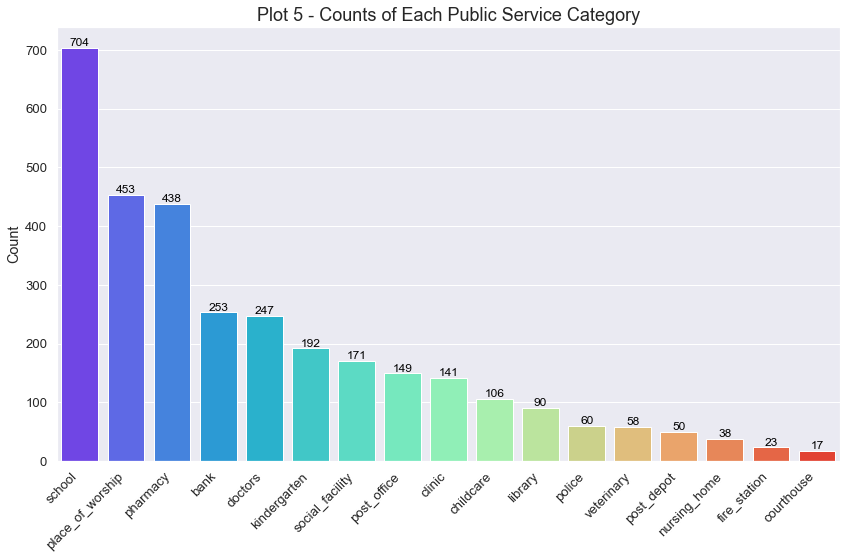

In [63]:
# Set the Seaborn style
sns.set(style='darkgrid', font_scale=1.2)

# Create a bar plot using Seaborn
plt.figure(figsize=(12, 8))
sns.barplot(x=category_counts.index, y=category_counts, palette='rainbow')

# Add count labels on top of each bar
for index, value in enumerate(category_counts):
    plt.text(index, value, str(value), ha='center', va='bottom', fontsize=12, color='black')

plt.ylabel('Count')
plt.title('Plot 5 - Counts of Each Public Service Category', fontsize=18)
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

In [64]:
# Create a map centered around Dublin
latitude = location[0]  # Latitude of the center point
longitude = location[1] # Longitude of the center point
map_osm = folium.Map(location=[latitude, longitude], zoom_start=12)
# icon = folium.Icon(icon='circle', prefix='fa', color='blue', icon_color='white', icon_size=(4, 4))

# Add markers for each public service spot
for index, spot in public_services_final.iterrows():
    name = spot['public_services_address']
    lat = spot['public_services_latitude']
    lon = spot['public_services_longitude']
    marker = folium.CircleMarker(location=[lat, lon], radius=4, popup=name, color='blue', fill=True, fill_color='blue')
    marker.add_to(map_osm)

# Display the map
map_osm

### <div style="text-align: right">[Back to top ↑](#top)</div>

# Places of Recreation and Tourist Spots in Dublin

This section focuses on identifying the diverse recreational hubs and popular tourist attractions spread across Dublin. From restaurants, cafes, pubs to cinemas and entertainment venues, these spots play a crucial role in enriching the city's cultural fabric and attracting tourists from around the world. Understanding the distribution and accessibility of these recreation and tourist spots is essential for effective urban planning and sustainable tourism development.

In the context of our project, these locations present an exciting opportunity to enhance the appeal of electric vehicle charging stations in Dublin. By strategically locating charging stations near places of recreation and tourist interest, we can cater to the needs of both local residents and visitors, encouraging the use of electric vehicles for sightseeing and leisure activities. This integration of electric vehicle infrastructure with tourist spots fosters eco-friendly tourism and showcases the city's commitment to sustainability and environmental conservation.

Analyzing the spatial relationship between these spots and potential charging station locations allows us to identify areas with high visitor footfall, thereby ensuring the availability of convenient charging options for people. Utilizing this information in our optimization model helps in designing a well-balanced network of charging stations, supporting sustainable tourism while reducing greenhouse gas emissions.

The rationale for using a 25 km radius applies here as well. This precautionary measure allows us to map relevant features to the hotspots at the periphery of our 25 km radius, providing a comprehensive and accurate representation of all the hotspots under our consideration.

In [65]:
rec_tourist_tags = ['restaurant', 'cafe', 'pub', 'bar', 'theatre', 'arts_centre', 'cinema', 'nightclub']

In [66]:
# Filter the data for the recreational/tourist spots in the same 25 Km radius
rec_tourist_spots = gdf[gdf['amenity'].isin(rec_tourist_tags)]

In [67]:
rec_tourist_spots.shape

(3144, 672)

In [68]:
rec_tourist_spots = pd.DataFrame(rec_tourist_spots)

# Remove all the columns which have less than 10% of the records populated
selected_columns = rec_tourist_spots.columns[rec_tourist_spots.count() > 0.1*len(rec_tourist_spots)]
rec_tourist_spots = rec_tourist_spots[selected_columns]

In [69]:
rec_tourist_spots.shape

(3144, 21)

In [70]:
rec_tourist_spots.head()

amenity                   geometry  \
element_type osmid                                              
node         132814618         pub  POINT (-6.37740 53.35007)   
             133193958         pub  POINT (-6.26059 53.33055)   
             254949231      cinema  POINT (-6.39372 53.35211)   
             263366607         pub  POINT (-6.42389 53.34739)   
             278857702  restaurant  POINT (-6.26192 53.34578)   

                                     name      addr:street email  \
element_type osmid                                                 
node         132814618     Silver Granite              NaN   NaN   
             133193958      The Barge Bar  Charlemont Mall   NaN   
             254949231  Vue Cinema Dublin              NaN   NaN   
             263366607     The Penny Hill      Castle Road   NaN   
             278857702         La Gondola      Bedford Row   NaN   

                       opening_hours  \
element_type osmid                     
node         132814618           NaN   
             133193958           NaN   
             254949231           NaN   
             263366607           NaN   
             278857702           NaN   

                                                               phone  \
element_type osmid                                                     
node         132814618                                           NaN   
             133193958                                           NaN   
             254949231  https://www.myvue.com/cinema/dublin/whats-on   
             263366607                                           NaN   
             278857702                                           NaN   

                       addr:city                      contact:facebook  \
element_type osmid                                                       
node         132814618       NaN                                   NaN   
             133193958    Dublin  https://www.facebook.com/thebargeinn   
             254949231       NaN                            VueCinemas   
             263366607     Lucan                                   NaN   
             278857702    Dublin                                   NaN   

                                                             website  ...  \
element_type osmid                                                    ...   
node         132814618                                           NaN  ...   
             133193958                      https://www.thebarge.ie/  ...   
             254949231  https://www.myvue.com/cinema/dublin/whats-on  ...   
             263366607                    https://pennyhilllucan.ie/  ...   
             278857702                     https://www.lagondola.ie/  ...   

                       addr:country addr:county addr:postcode  \
element_type osmid                                              
node         132814618          NaN         NaN           NaN   
             133193958          NaN         NaN           NaN   
             254949231          NaN         NaN           NaN   
             263366607           IE      Dublin      K78 Y6P9   
             278857702          NaN         NaN           NaN   

                       addr:housenumber  cuisine takeaway smoking  \
element_type osmid                                                  
node         132814618              NaN      NaN      NaN     NaN   
             133193958              NaN      NaN      NaN     NaN   
             254949231              NaN      NaN      NaN     NaN   
             263366607              NaN      NaN      NaN     NaN   
             278857702              NaN  italian      NaN     NaN   

                       outdoor_seating building nodes  
element_type osmid                                     
node         132814618             NaN      NaN   NaN  
             133193958             NaN      NaN   NaN  
             254949231             NaN      NaN   NaN  
             263366607       

In [71]:
rec_tourist_spots.columns

Index(['amenity', 'geometry', 'name', 'addr:street', 'email', 'opening_hours',
       'phone', 'addr:city', 'contact:facebook', 'website', 'wheelchair',
       'addr:country', 'addr:county', 'addr:postcode', 'addr:housenumber',
       'cuisine', 'takeaway', 'smoking', 'outdoor_seating', 'building',
       'nodes'],
      dtype='object')

In [72]:
# Creating separate columns for the latitude and longitude
rec_tourist_spots['rec_tourist_spots_latitude'] = rec_tourist_spots['geometry'].apply(lambda point: point.y if isinstance(point, Point) else point.centroid.y)
rec_tourist_spots['rec_tourist_spots_longitude'] = rec_tourist_spots['geometry'].apply(lambda point: point.x if isinstance(point, Point) else point.centroid.x)

In [73]:
# Pick only the features/columns which will be useful for our analysis 
rec_tourist_spots_final = rec_tourist_spots[['rec_tourist_spots_latitude', 'rec_tourist_spots_longitude', 'amenity', 'name', 'addr:street', 'addr:city']]

In [74]:
# Rename the column names for downstream use
rec_tourist_spots_final = rec_tourist_spots_final.rename(columns={
                                              'amenity': 'rec_tourist_spots_tag', 
                                              'name': 'rec_tourist_spots_address',
                                              'addr:street': 'rec_tourist_spots_street',
                                              'addr:city': 'rec_tourist_spots_city'})

In [75]:
rec_tourist_spots_final.reset_index(drop=True).head()

,rec_tourist_spots_latitude,rec_tourist_spots_longitude,rec_tourist_spots_tag,rec_tourist_spots_address,rec_tourist_spots_street,rec_tourist_spots_city
0,53.350075,-6.377403,pub,Silver Granite,NaN,NaN
1,53.330551,-6.260588,pub,The Barge Bar,Charlemont Mall,Dublin
2,53.352109,-6.393719,cinema,Vue Cinema Dublin,NaN,NaN
3,53.347390,-6.423887,pub,The Penny Hill,Castle Road,Lucan
4,53.345784,-6.261924,restaurant,La Gondola,Bedford Row,Dublin


In [76]:
print("The total number of recreational places and tourist spots considered for our analysis is", len(rec_tourist_spots_final))

The total number of recreational places and tourist spots considered for our analysis is 3144


In [77]:
# Get the counts of each hotspot category
category_counts = rec_tourist_spots_final['rec_tourist_spots_tag'].value_counts()

E:\Anaconda\lib\site-packages\seaborn\rcmod.py:400: DeprecationWarning:

distutils Version classes are deprecated. Use packaging.version instead.

E:\Anaconda\lib\site-packages\setuptools\_distutils\version.py:351: DeprecationWarning:

distutils Version classes are deprecated. Use packaging.version instead.



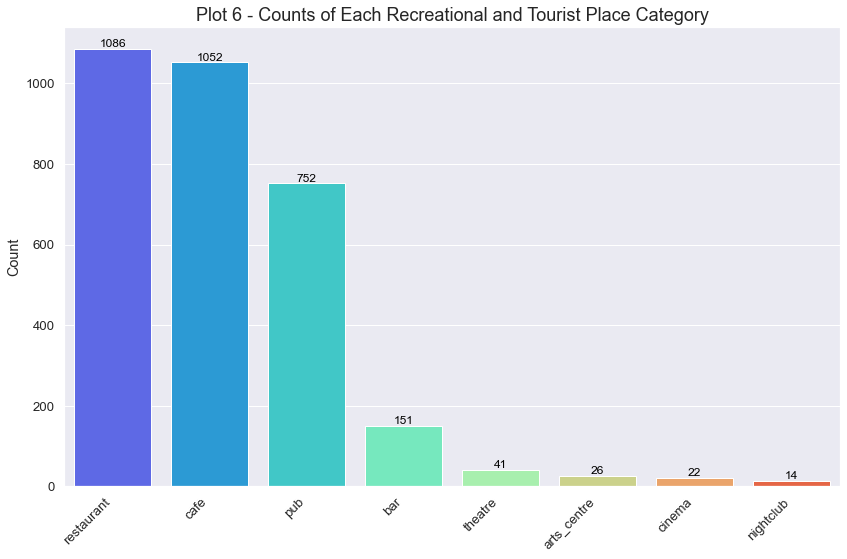

In [78]:
# Set the Seaborn style
sns.set(style='darkgrid', font_scale=1.2)

# Create a bar plot using Seaborn
plt.figure(figsize=(12, 8))
sns.barplot(x=category_counts.index, y=category_counts, palette='rainbow')

# Add count labels on top of each bar
for index, value in enumerate(category_counts):
    plt.text(index, value, str(value), ha='center', va='bottom', fontsize=12, color='black')

plt.ylabel('Count')
plt.title('Plot 6 - Counts of Each Recreational and Tourist Place Category', fontsize=18)
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

In [79]:
# Create a map centered around Dublin
latitude = location[0]  # Latitude of the center point
longitude = location[1] # Longitude of the center point
map_osm = folium.Map(location=[latitude, longitude], zoom_start=12)
# icon = folium.Icon(icon='circle', prefix='fa', color='blue', icon_color='white', icon_size=(4, 4))

# Add markers for each recreational place and tourist spot
for index, spot in rec_tourist_spots_final.iterrows():
    name = spot['rec_tourist_spots_address']
    lat = spot['rec_tourist_spots_latitude']
    lon = spot['rec_tourist_spots_longitude']
    marker = folium.CircleMarker(location=[lat, lon], radius=4, popup=name, color='purple', fill=True, fill_color='purple')
    marker.add_to(map_osm)

# Display the map
map_osm

.

In [80]:
# Create Point geometries for all hotspots
hotspots_final['hotspot_geometry'] = [Point(x, y) for x, y in zip(hotspots_final['hotspot_longitude'], hotspots_final['hotspot_latitude'])]

In [81]:
import pandas as pd
df = pd.read_csv("HP_Index.csv", encoding= 'unicode_escape')


In [82]:
# Filtering only for Dublin since our analysis is focused here
dublin_df = pd.DataFrame(df[df["NUTS3"] == "Dublin"])


In [83]:
# Filtering for only those features that are relevant for our analysis
final_df = dublin_df[["ED_Name","TOTPOP16"]].reset_index(drop=True)


In [84]:

# Rename the column names for downstream use
final_df = final_df.rename(columns={'ED_Name':'name','TOTPOP16': 'total_population_2016'})

In [85]:
# Convert the population data from string to integer
final_df['total_population_2016'] = final_df['total_population_2016'].str.replace(',', '').astype(int)

In [86]:
warnings.filterwarnings('ignore')

geo_df = gpd.read_file("electoral_divisions.geojson")

In [87]:
# Updating the names for a few places as they are slightly different between the 2 datasets
update_values = {
    'CARNA': 'CHERRY ORCHARD B (CARNA)',
    'DALKEY UPPER': 'DALKEY-UPPER',
    'DUN LAOGHAIRE SALLYNOGGIN EAST': 'DUN LAOGHAIRE-SALLYNOGIN EAST',
    'DUN LAOGHAIRE-SALLYNOGGIN WEST': 'DUN LAOGHAIRE-SALLYNOGIN WEST',
    'DUN LAOGHAIRE SALLYNOGGIN SOUTH': 'DUN LAOGHAIRE-SALLYNOGIN SOUTH',
    'FOXROCK-DEANSGRANGE': 'FOXROCK-DEANS GRANGE',
    'KILLINEY NORTH': 'KILLINEY-NORTH',
    'KILLINEY SOUTH': 'KILLINEY-SOUTH',
    "LUCAN-St. HELENS": "LUCAN-ST. HELENS",
    'RAHENY-St. ASSAM': 'RAHENY-ST.ASSAM',
    "RATHFARNHAM-St. ENDA'S": "RATHFARNHAM-ST. ENDA'S",
    "SAINT KEVIN'S": "ST KEVIN'S",
    "TERENURE-St. JAMES": "TERENURE-ST. JAMES"
}

geo_df['ENGLISH'].replace(update_values, inplace=True)

In [88]:
# Merge the GeoDataFrame with the DataFrame based on the district name
merged_df = final_df.merge(geo_df, left_on='name', right_on='ENGLISH', how='left')

In [89]:
final_df.head()

,name,total_population_2016
0,ARRAN QUAY A,1785
1,ARRAN QUAY B,4166
2,ARRAN QUAY C,4471
3,ARRAN QUAY D,3109
4,ARRAN QUAY E,3293


In [90]:
# Function to process hotspots in batches of 100 rows
def process_hotspot_batch(hotspot_batch, merged_df, batch_num, total_batches):
    processed_hotspots = []
    for _, hotspot_row in hotspot_batch.iterrows():
        hotspot_point = hotspot_row['hotspot_geometry']
        
        # Spatial join using apply() for better performance
        matches = merged_df[merged_df['geometry'].apply(lambda x: hotspot_point.within(shape(x)))]
        
        if not matches.empty:
            # Take the first matching row (you can change the logic if needed)
            matched_row = matches.iloc[0]
            hotspot_row['name'] = matched_row['name']
            #hotspot_row['hp_index_2016'] = matched_row['hp_index_2016']
            hotspot_row['total_population_2016'] = matched_row['total_population_2016']
            #hotspot_row['Income'] = matched_row['Income']
            processed_hotspots.append(hotspot_row)
    
    print(f"Processed batch {batch_num}/{total_batches}.....")
    return processed_hotspots

# Split hotspots into batches of 100 rows
batch_size = 100
hotspot_batches = [hotspots_final[i:i+batch_size] for i in range(0, len(hotspots_final), batch_size)]

# Map the districts to each hotspot in batches
result_hotspots = []
total_batches = len(hotspot_batches)
for batch_num, hotspot_batch in enumerate(hotspot_batches, 1):
    processed_hotspots = process_hotspot_batch(hotspot_batch, merged_df, batch_num, total_batches)
    result_hotspots.extend(processed_hotspots)

# Convert the result to a DataFrame
result_df = pd.DataFrame(result_hotspots)

Processed batch 1/73.....
Processed batch 2/73.....
Processed batch 3/73.....
Processed batch 4/73.....
Processed batch 5/73.....
Processed batch 6/73.....
Processed batch 7/73.....
Processed batch 8/73.....
Processed batch 9/73.....
Processed batch 10/73.....
Processed batch 11/73.....
Processed batch 12/73.....
Processed batch 13/73.....
Processed batch 14/73.....
Processed batch 15/73.....
Processed batch 16/73.....
Processed batch 17/73.....
Processed batch 18/73.....
Processed batch 19/73.....
Processed batch 20/73.....
Processed batch 21/73.....
Processed batch 22/73.....
Processed batch 23/73.....
Processed batch 24/73.....
Processed batch 25/73.....
Processed batch 26/73.....
Processed batch 27/73.....
Processed batch 28/73.....
Processed batch 29/73.....
Processed batch 30/73.....
Processed batch 31/73.....
Processed batch 32/73.....
Processed batch 33/73.....
Processed batch 34/73.....
Processed batch 35/73.....
Processed batch 36/73.....
Processed batch 37/73.....
Processed 

In [91]:


# # Convert the result to a DataFrame
#result_df = pd.DataFrame(hotspots_final)

In [92]:
result_df.reset_index(drop=True).head()

,hotspot_latitude,hotspot_longitude,hotspot_tag,hotspot_location,hotspot_geometry,name,total_population_2016
0,53.383351,-6.417798,fuel,Applegreen,POINT (-6.4177977 53.3833507),BLANCHARDSTOWN-BLAKESTOWN,38894
1,53.399470,-6.306985,fuel,Circle K,POINT (-6.3069853 53.3994701),FINGLAS NORTH C,3464
2,53.253626,-6.247051,parking,NaN,POINT (-6.2470507 53.2536262),GLENCULLEN,19773
3,53.486778,-6.198035,fuel,Circle K,POINT (-6.1980345 53.4867775),DONABATE,9399
4,53.397200,-6.145321,fuel,Applegreen,POINT (-6.1453208 53.3971997),BALDOYLE,7524


In [93]:
# result_df_copy = result_df.copy()

In [94]:
# result_df = result_df_copy.copy()

.

# Objective Function Formulation

In [109]:
result_df_final.head()

,hotspot_latitude,hotspot_longitude,hotspot_tag,hotspot_location,hotspot_geometry,name,total_population_2016,avg_proximity_to_existing_ev_stations_,min_proximity_to_existing_ev_stations_,number_of_ev_stations_within_0.5_kms_,...,number_of_public_service_spots_within_0.5_kms,number_of_public_service_spots_within_1_kms,number_of_public_service_spots_within_2_kms,number_of_public_service_spots_within_5_kms,avg_proximity_to_existing_rec_and_tourist_spots,min_proximity_to_existing_rec_and_tourist_spots,number_of_rec_and_tourist_spots_within_0.5_kms,number_of_rec_and_tourist_spots_within_1_kms,number_of_rec_and_tourist_spots_within_2_kms,number_of_rec_and_tourist_spots_within_5_kms
0,53.383351,-6.417798,fuel,Applegreen,POINT (-6.4177977 53.3833507),BLANCHARDSTOWN-BLAKESTOWN,38894,14.280417,0.163198,1,...,2,5,41,235,13.262684,0.509858,0,2,21,142
1,53.399470,-6.306985,fuel,Circle K,POINT (-6.3069853 53.3994701),FINGLAS NORTH C,3464,11.414542,0.480921,4,...,2,13,59,350,10.153809,0.171850,2,9,29,198
2,53.253626,-6.247051,parking,NaN,POINT (-6.2470507 53.2536262),GLENCULLEN,19773,12.388711,1.400942,0,...,0,0,11,188,12.268314,1.049591,0,0,8,125
3,53.486778,-6.198035,fuel,Circle K,POINT (-6.1980345 53.4867775),DONABATE,9399,18.590820,0.660021,0,...,0,0,1,114,18.277014,1.945217,0,0,2,84
4,53.397200,-6.145321,fuel,Applegreen,POINT (-6.1453208 53.3971997),BALDOYLE,7524,13.427554,1.090242,0,...,4,21,53,198,12.553819,0.257531,1,6,24,106


In [110]:
coord_df = result_df_final[['hotspot_latitude', 'hotspot_longitude']]

In [111]:
from sklearn.metrics.pairwise import haversine_distances
import numpy as np
from sklearn.cluster import DBSCAN
# Calculate pairwise distances between all points in kilometers using Haversine formula
dist_matrix_km = haversine_distances(np.radians(coord_df[['hotspot_latitude', 'hotspot_longitude']])) * 6371.0

# Initialize DBSCAN with the desired parameters
eps = 0.15  # The maximum distance (in kms) between two samples to be considered as part of the same neighborhood
min_samples = 1  # The minimum number of samples required in a neighborhood to be considered as a core point

dbscan = DBSCAN(eps=eps, min_samples=min_samples, metric='precomputed')

# Fit DBSCAN to the distance matrix
result_df_final['cluster_label'] = dbscan.fit_predict(dist_matrix_km)

In [112]:
# Initialize DBSCAN with the desired parameters
#eps = 0.002  # The maximum distance (in degrees) between two samples to be considered as part of the same neighborhood
#min_samples = 1  # The minimum number of samples required in a neighborhood to be considered as a core point

#dbscan = DBSCAN(eps=eps, min_samples=min_samples)

# Fit DBSCAN to the coordinate data
#result_df_final['cluster_label'] = dbscan.fit_predict(coord_df)

In [113]:
result_df_final['cluster_label'].nunique()

1680

In [114]:
result_df_final.head()

,hotspot_latitude,hotspot_longitude,hotspot_tag,hotspot_location,hotspot_geometry,name,total_population_2016,avg_proximity_to_existing_ev_stations_,min_proximity_to_existing_ev_stations_,number_of_ev_stations_within_0.5_kms_,...,number_of_public_service_spots_within_1_kms,number_of_public_service_spots_within_2_kms,number_of_public_service_spots_within_5_kms,avg_proximity_to_existing_rec_and_tourist_spots,min_proximity_to_existing_rec_and_tourist_spots,number_of_rec_and_tourist_spots_within_0.5_kms,number_of_rec_and_tourist_spots_within_1_kms,number_of_rec_and_tourist_spots_within_2_kms,number_of_rec_and_tourist_spots_within_5_kms,cluster_label
0,53.383351,-6.417798,fuel,Applegreen,POINT (-6.4177977 53.3833507),BLANCHARDSTOWN-BLAKESTOWN,38894,14.280417,0.163198,1,...,5,41,235,13.262684,0.509858,0,2,21,142,0
1,53.399470,-6.306985,fuel,Circle K,POINT (-6.3069853 53.3994701),FINGLAS NORTH C,3464,11.414542,0.480921,4,...,13,59,350,10.153809,0.171850,2,9,29,198,1
2,53.253626,-6.247051,parking,NaN,POINT (-6.2470507 53.2536262),GLENCULLEN,19773,12.388711,1.400942,0,...,0,11,188,12.268314,1.049591,0,0,8,125,2
3,53.486778,-6.198035,fuel,Circle K,POINT (-6.1980345 53.4867775),DONABATE,9399,18.590820,0.660021,0,...,0,1,114,18.277014,1.945217,0,0,2,84,3
4,53.397200,-6.145321,fuel,Applegreen,POINT (-6.1453208 53.3971997),BALDOYLE,7524,13.427554,1.090242,0,...,21,53,198,12.553819,0.257531,1,6,24,106,4


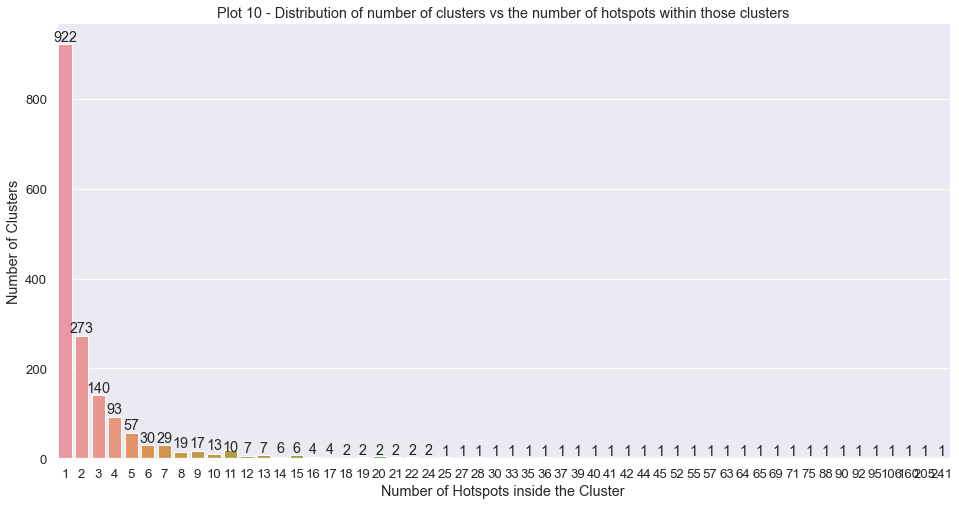

In [115]:
# Set the Seaborn style
sns.set(style='darkgrid', font_scale=1.2)

# Assuming you have the result_df_final DataFrame with the 'cluster_label' column
cluster_counts = result_df_final['cluster_label'].value_counts()

# Grouping by the 'cluster_label' and getting the counts of hotspots in each cluster
grouped_counts = cluster_counts.groupby(cluster_counts).count().reset_index(name='num_clusters')

# Sorting the grouped_counts DataFrame by cluster count in descending order
grouped_counts = grouped_counts.sort_values(by='num_clusters', ascending=False)

# Plotting the grouped bar plot using Seaborn
plt.figure(figsize=(16, 8))
sns.barplot(x='cluster_label', y='num_clusters', data=grouped_counts)
plt.xlabel('Number of Hotspots inside the Cluster')
plt.ylabel('Number of Clusters')
plt.title('Plot 10 - Distribution of number of clusters vs the number of hotspots within those clusters')

# Add labels on top of the bars
for index, value in enumerate(grouped_counts['num_clusters']):
    plt.text(index, value, str(value), ha='center', va='bottom')
    
plt.show()

As we could see, there are 921 clusters which have just 1 hotspot implying that they arent surrounded by other hotspots nearby. But at the same time there are some clusters with more than 200 points within them implying that these are very close to each other and thus it wouldnt make sense to treat them as separate hotspots.

In [116]:
# Create a new DataFrame to store the representative points
from geopy.distance import geodesic
designated_points = pd.DataFrame(columns=['cluster_label', 'hotspot_latitude', 'hotspot_longitude'])

# Loop through each unique cluster label
for cluster_label in result_df_final['cluster_label'].unique():
    # Filter the data for the current cluster
    cluster_data = result_df_final[result_df_final['cluster_label'] == cluster_label]
    
    if len(cluster_data) == 1:
        # If there's only one point in the cluster, directly append it as the representative point
        designated_points = designated_points.append({
            'cluster_label': cluster_label,
            'hotspot_latitude': cluster_data['hotspot_latitude'].iloc[0],
            'hotspot_longitude': cluster_data['hotspot_longitude'].iloc[0]
        }, ignore_index=True)
    else:
        # Calculate the centroid (designated point) of the cluster
        centroid_lat = cluster_data['hotspot_latitude'].mean()
        centroid_lon = cluster_data['hotspot_longitude'].mean()

        # Calculate the Haversine distance of each point in the cluster from the centroid
        distances = cluster_data.apply(lambda row: geodesic((centroid_lat, centroid_lon), (row['hotspot_latitude'], row['hotspot_longitude'])).kilometers, axis=1)

        # Get the index of the point with the smallest distance (closest to the centroid)
        closest_point_index = distances.idxmin()

        # Append the closest point to the designated_points DataFrame
        closest_point = cluster_data.loc[closest_point_index]
        designated_points = designated_points.append({
            'cluster_label': cluster_label,
            'hotspot_latitude': closest_point['hotspot_latitude'],
            'hotspot_longitude': closest_point['hotspot_longitude']
        }, ignore_index=True)

In [117]:
designated_points.head()

,cluster_label,hotspot_latitude,hotspot_longitude
0,0.0,53.383351,-6.417798
1,1.0,53.39947,-6.306985
2,2.0,53.25385,-6.249113
3,3.0,53.486778,-6.198035
4,4.0,53.3972,-6.145321


In [118]:
# Merge the 'representative_points' DataFrame with the 'result_df_final' DataFrame
final_df = pd.merge(result_df_final, designated_points, on=['cluster_label', 'hotspot_latitude', 'hotspot_longitude'])

In [119]:
final_df.head()

,hotspot_latitude,hotspot_longitude,hotspot_tag,hotspot_location,hotspot_geometry,name,total_population_2016,avg_proximity_to_existing_ev_stations_,min_proximity_to_existing_ev_stations_,number_of_ev_stations_within_0.5_kms_,...,number_of_public_service_spots_within_1_kms,number_of_public_service_spots_within_2_kms,number_of_public_service_spots_within_5_kms,avg_proximity_to_existing_rec_and_tourist_spots,min_proximity_to_existing_rec_and_tourist_spots,number_of_rec_and_tourist_spots_within_0.5_kms,number_of_rec_and_tourist_spots_within_1_kms,number_of_rec_and_tourist_spots_within_2_kms,number_of_rec_and_tourist_spots_within_5_kms,cluster_label
0,53.383351,-6.417798,fuel,Applegreen,POINT (-6.4177977 53.3833507),BLANCHARDSTOWN-BLAKESTOWN,38894,14.280417,0.163198,1,...,5,41,235,13.262684,0.509858,0,2,21,142,0
1,53.39947,-6.306985,fuel,Circle K,POINT (-6.3069853 53.3994701),FINGLAS NORTH C,3464,11.414542,0.480921,4,...,13,59,350,10.153809,0.171850,2,9,29,198,1
2,53.486778,-6.198035,fuel,Circle K,POINT (-6.1980345 53.4867775),DONABATE,9399,18.590820,0.660021,0,...,0,1,114,18.277014,1.945217,0,0,2,84,3
3,53.3972,-6.145321,fuel,Applegreen,POINT (-6.1453208 53.3971997),BALDOYLE,7524,13.427554,1.090242,0,...,21,53,198,12.553819,0.257531,1,6,24,106,4
4,53.522923,-6.098178,fuel,Rush Oil Co.,POINT (-6.098178 53.522923),RUSH,9921,24.365067,0.270509,1,...,14,16,47,24.163783,0.021901,9,13,15,25,5


In [120]:
# Create a map centered around Dublin
latitude = location[0]  # Latitude of the center point
longitude = location[1] # Longitude of the center point
map_osm = folium.Map(location=[latitude, longitude], zoom_start=12)
# icon = folium.Icon(icon='circle', prefix='fa', color='blue', icon_color='white', icon_size=(4, 4))

# Add a transparent 25 km radius circle from the center of Dublin 
# (to indicate the radius within which we considered all of the public spots, existing charging stations, tourist spots)
# folium.Circle(
#     location=[latitude, longitude],
#     radius=25000,
#     color='orange',
#     fill=True, 
#     fill_opacity=0.4,  
#     fill_color='orange', 
# ).add_to(map_osm)

# Add markers for each potential hotspot
for index, spot in final_df.iterrows():
    name = spot['hotspot_location']
    lat = spot['hotspot_latitude']
    lon = spot['hotspot_longitude']
    # marker = folium.Icon(color='green', icon='map-marker')
    marker = folium.CircleMarker(location=[lat, lon], radius=4, popup=name, color='green', fill=True, fill_color='red')
    marker.add_to(map_osm)


# Display the map
map_osm

In [121]:
warnings.filterwarnings('ignore')

geo_df = gpd.read_file("electoral_divisions.geojson")
geo_df.head()

,ED_ID,ENGLISH,GAEILGE,CONTAE,COUNTY,PROVINCE,GUID,CENTROID_X,CENTROID_Y,AREA,ESRI_OID,Shape__Area,Shape__Length,geometry
0,267160,TURNAPIN,Turnapain,Baile Átha Cliath,DUBLIN,Leinster,2ae19629-1cea-13a3-e055-000000000001,717365.57,740807.88,943505.13,1,9.435051e+05,4732.251966,"POLYGON ((-6.22935 53.41140, -6.22871 53.41140..."
1,267034,BLANCHARDSTOWN-TYRRELSTOWN,Baile Bhlainséir-Baile an Tirialaigh,Baile Átha Cliath,DUBLIN,Leinster,2ae19629-1cdf-13a3-e055-000000000001,705543.55,741492.45,3927075.85,6,3.927076e+06,9876.548268,"POLYGON ((-6.43417 53.40967, -6.43409 53.40977..."
2,267035,BOHERNABREENA,Bóthar na Bruíne,Baile Átha Cliath,DUBLIN,Leinster,2ae19629-1ce0-13a3-e055-000000000001,711258.06,720929.15,43938821.49,8,4.393882e+07,32370.056448,"POLYGON ((-6.37779 53.26812, -6.37772 53.26812..."
3,267091,GARRISTOWN,Baile Gháire,Baile Átha Cliath,DUBLIN,Leinster,2ae19629-1d7d-13a3-e055-000000000001,707351.47,757206.45,35597702.89,47,3.559770e+07,31158.405801,"POLYGON ((-6.34883 53.57492, -6.34884 53.57490..."
4,268146,TERENURE C,Tír an Iúir C,Baile Átha Cliath,DUBLIN,Leinster,2ae19629-1df2-13a3-e055-000000000001,713708.94,729864.27,707434.23,49,7.074342e+05,3581.171798,"POLYGON ((-6.28465 53.30955, -6.28468 53.30954..."


In [122]:
# Updating the names for a few places as they are slightly different between the 2 datasets
update_values = {
    'CARNA': 'CHERRY ORCHARD B (CARNA)',
    'DALKEY UPPER': 'DALKEY-UPPER',
    'DUN LAOGHAIRE SALLYNOGGIN EAST': 'DUN LAOGHAIRE-SALLYNOGIN EAST',
    'DUN LAOGHAIRE-SALLYNOGGIN WEST': 'DUN LAOGHAIRE-SALLYNOGIN WEST',
    'DUN LAOGHAIRE SALLYNOGGIN SOUTH': 'DUN LAOGHAIRE-SALLYNOGIN SOUTH',
    'FOXROCK-DEANSGRANGE': 'FOXROCK-DEANS GRANGE',
    'KILLINEY NORTH': 'KILLINEY-NORTH',
    'KILLINEY SOUTH': 'KILLINEY-SOUTH',
    "LUCAN-St. HELENS": "LUCAN-ST. HELENS",
    'RAHENY-St. ASSAM': 'RAHENY-ST.ASSAM',
    "RATHFARNHAM-St. ENDA'S": "RATHFARNHAM-ST. ENDA'S",
    "SAINT KEVIN'S": "ST KEVIN'S",
    "TERENURE-St. JAMES": "TERENURE-ST. JAMES"
}

geo_df['ENGLISH'].replace(update_values, inplace=True)

In [123]:
final_df.head()

,hotspot_latitude,hotspot_longitude,hotspot_tag,hotspot_location,hotspot_geometry,name,total_population_2016,avg_proximity_to_existing_ev_stations_,min_proximity_to_existing_ev_stations_,number_of_ev_stations_within_0.5_kms_,...,number_of_public_service_spots_within_1_kms,number_of_public_service_spots_within_2_kms,number_of_public_service_spots_within_5_kms,avg_proximity_to_existing_rec_and_tourist_spots,min_proximity_to_existing_rec_and_tourist_spots,number_of_rec_and_tourist_spots_within_0.5_kms,number_of_rec_and_tourist_spots_within_1_kms,number_of_rec_and_tourist_spots_within_2_kms,number_of_rec_and_tourist_spots_within_5_kms,cluster_label
0,53.383351,-6.417798,fuel,Applegreen,POINT (-6.4177977 53.3833507),BLANCHARDSTOWN-BLAKESTOWN,38894,14.280417,0.163198,1,...,5,41,235,13.262684,0.509858,0,2,21,142,0
1,53.39947,-6.306985,fuel,Circle K,POINT (-6.3069853 53.3994701),FINGLAS NORTH C,3464,11.414542,0.480921,4,...,13,59,350,10.153809,0.171850,2,9,29,198,1
2,53.486778,-6.198035,fuel,Circle K,POINT (-6.1980345 53.4867775),DONABATE,9399,18.590820,0.660021,0,...,0,1,114,18.277014,1.945217,0,0,2,84,3
3,53.3972,-6.145321,fuel,Applegreen,POINT (-6.1453208 53.3971997),BALDOYLE,7524,13.427554,1.090242,0,...,21,53,198,12.553819,0.257531,1,6,24,106,4
4,53.522923,-6.098178,fuel,Rush Oil Co.,POINT (-6.098178 53.522923),RUSH,9921,24.365067,0.270509,1,...,14,16,47,24.163783,0.021901,9,13,15,25,5


In [124]:
# Bringing in the geometry of the district for each of these hotspots using the geojson file
final_df = final_df.merge(geo_df[['ENGLISH', 'geometry']],left_on='name', right_on='ENGLISH',how='left')

In [125]:
# Create a GeoDataFrame from the DataFrame
gdf = gpd.GeoDataFrame(final_df, geometry='geometry')

In [126]:
# Calculating the Population density for each coordinate by dividing the population by the actual area (in km2)

# Reproject the GeoDataFrame to a CRS that uses meters (EPSG:3857)
gdf = gdf.to_crs(epsg=3857)

# Calculating the area in km2
gdf['area'] = (gdf['geometry'].area) / 1000000

# Calculate population density for each hotspot in population/km2
gdf['population_density_sq_km'] = gdf['total_population_2016'] / gdf['area']

In [127]:
#Creating a new column for easier identification
gdf['ID'] = 'OPTIMAL_HOTSPOT_' + gdf['cluster_label'].astype(str)

In [128]:
# Drop the redundant columns
gdf.drop('ENGLISH', axis=1, inplace=True)
gdf.drop('cluster_label', axis=1, inplace=True)

In [129]:
# Reordering the columns for easier viz
cols = list(gdf.columns)
new_col_idx = cols.index('ID')

# Move the 'new_column' to the front of the list
cols = ['ID'] + cols[:new_col_idx] + cols[new_col_idx+1:]

# Reorder the DataFrame columns
gdf = gdf[cols]

In [130]:
gdf.head()

,ID,hotspot_latitude,hotspot_longitude,hotspot_tag,hotspot_location,hotspot_geometry,name,total_population_2016,avg_proximity_to_existing_ev_stations_,min_proximity_to_existing_ev_stations_,...,number_of_public_service_spots_within_5_kms,avg_proximity_to_existing_rec_and_tourist_spots,min_proximity_to_existing_rec_and_tourist_spots,number_of_rec_and_tourist_spots_within_0.5_kms,number_of_rec_and_tourist_spots_within_1_kms,number_of_rec_and_tourist_spots_within_2_kms,number_of_rec_and_tourist_spots_within_5_kms,geometry,area,population_density_sq_km
0,OPTIMAL_HOTSPOT_0,53.383351,-6.417798,fuel,Applegreen,POINT (-6.4177977 53.3833507),BLANCHARDSTOWN-BLAKESTOWN,38894,14.280417,0.163198,...,235,13.262684,0.509858,0,2,21,142,"POLYGON ((-712233.301 7057856.127, -712265.561...",22.102194,1759.734777
1,OPTIMAL_HOTSPOT_1,53.39947,-6.306985,fuel,Circle K,POINT (-6.3069853 53.3994701),FINGLAS NORTH C,3464,11.414542,0.480921,...,350,10.153809,0.171850,2,9,29,198,"POLYGON ((-702405.575 7057778.805, -702394.534...",3.123213,1109.114376
2,OPTIMAL_HOTSPOT_3,53.486778,-6.198035,fuel,Circle K,POINT (-6.1980345 53.4867775),DONABATE,9399,18.590820,0.660021,...,114,18.277014,1.945217,0,0,2,84,"MULTIPOLYGON (((-687113.392 7070327.834, -6871...",68.820609,136.572461
3,OPTIMAL_HOTSPOT_4,53.3972,-6.145321,fuel,Applegreen,POINT (-6.1453208 53.3971997),BALDOYLE,7524,13.427554,1.090242,...,198,12.553819,0.257531,1,6,24,106,"POLYGON ((-684819.622 7056446.960, -684816.914...",7.512741,1001.498679
4,OPTIMAL_HOTSPOT_5,53.522923,-6.098178,fuel,Rush Oil Co.,POINT (-6.098178 53.522923),RUSH,9921,24.365067,0.270509,...,47,24.163783,0.021901,9,13,15,25,"POLYGON ((-680972.168 7082054.136, -680957.777...",19.122446,518.814388


In [131]:
# Normalizing the population density column
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()

gdf['normalized_pop_density'] = scaler.fit_transform(gdf[['population_density_sq_km']])

In [132]:
gdf.head()

,ID,hotspot_latitude,hotspot_longitude,hotspot_tag,hotspot_location,hotspot_geometry,name,total_population_2016,avg_proximity_to_existing_ev_stations_,min_proximity_to_existing_ev_stations_,...,avg_proximity_to_existing_rec_and_tourist_spots,min_proximity_to_existing_rec_and_tourist_spots,number_of_rec_and_tourist_spots_within_0.5_kms,number_of_rec_and_tourist_spots_within_1_kms,number_of_rec_and_tourist_spots_within_2_kms,number_of_rec_and_tourist_spots_within_5_kms,geometry,area,population_density_sq_km,normalized_pop_density
0,OPTIMAL_HOTSPOT_0,53.383351,-6.417798,fuel,Applegreen,POINT (-6.4177977 53.3833507),BLANCHARDSTOWN-BLAKESTOWN,38894,14.280417,0.163198,...,13.262684,0.509858,0,2,21,142,"POLYGON ((-712233.301 7057856.127, -712265.561...",22.102194,1759.734777,0.204796
1,OPTIMAL_HOTSPOT_1,53.39947,-6.306985,fuel,Circle K,POINT (-6.3069853 53.3994701),FINGLAS NORTH C,3464,11.414542,0.480921,...,10.153809,0.171850,2,9,29,198,"POLYGON ((-702405.575 7057778.805, -702394.534...",3.123213,1109.114376,0.128484
2,OPTIMAL_HOTSPOT_3,53.486778,-6.198035,fuel,Circle K,POINT (-6.1980345 53.4867775),DONABATE,9399,18.590820,0.660021,...,18.277014,1.945217,0,0,2,84,"MULTIPOLYGON (((-687113.392 7070327.834, -6871...",68.820609,136.572461,0.014413
3,OPTIMAL_HOTSPOT_4,53.3972,-6.145321,fuel,Applegreen,POINT (-6.1453208 53.3971997),BALDOYLE,7524,13.427554,1.090242,...,12.553819,0.257531,1,6,24,106,"POLYGON ((-684819.622 7056446.960, -684816.914...",7.512741,1001.498679,0.115861
4,OPTIMAL_HOTSPOT_5,53.522923,-6.098178,fuel,Rush Oil Co.,POINT (-6.098178 53.522923),RUSH,9921,24.365067,0.270509,...,24.163783,0.021901,9,13,15,25,"POLYGON ((-680972.168 7082054.136, -680957.777...",19.122446,518.814388,0.059246


In [136]:
# Create a map centered around Dublin
latitude = 53.349805
longitude = -6.26031
map_osm = folium.Map(location=[latitude, longitude], zoom_start=11)

# Function to define circle color and radius based on the hotspot's radius
def get_circle_style(radius):
    if radius == largest_radius:
        circle_color = 'green'
        circle_radius = radius * 1000  # Convert the radius to meters for visualization
    elif radius == smallest_radius:
        circle_color = 'red'
        circle_radius = radius * 1000  # Convert the radius to meters for visualization
    else:
        circle_color = None
        circle_radius = None

    return circle_color, circle_radius

# Find the largest and smallest radius
largest_radius = gdf['sphere_radius'].max()
smallest_radius = gdf['sphere_radius'].min()

# Add markers for each hotspot with a circle around it
for index, spot in gdf.iterrows():
    name = spot['hotspot_location']
    lat = spot['hotspot_latitude']
    lon = spot['hotspot_longitude']
    radius = spot['sphere_radius']
    
    circle_color, circle_radius = get_circle_style(radius)
    
    # Add the circle around the marker (if applicable)
    if circle_color:
        popup = f"Name: {spot['hotspot_location']}<br>Location:  {spot['name']}<br>Tag: {spot['hotspot_tag']}<br>Radius: {round(radius,2)} Km"
        # Add the marker (pin)
        folium.Marker([lat, lon], popup= popup, color='red').add_to(map_osm)
        
        folium.Circle(
            location=[lat, lon],
            radius=circle_radius,
            color=circle_color,
            fill=True,
            fill_color=circle_color,
            fill_opacity=0.4
        ).add_to(map_osm)

# Display the map
map_osm

In [137]:
df = gdf.copy()

In [150]:
df.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 1680 entries, 0 to 1679
Data columns (total 51 columns):
 #   Column                                                      Non-Null Count  Dtype   
---  ------                                                      --------------  -----   
 0   ID                                                          1680 non-null   object  
 1   hotspot_latitude                                            1680 non-null   object  
 2   hotspot_longitude                                           1680 non-null   object  
 3   hotspot_tag                                                 1680 non-null   object  
 4   hotspot_location                                            307 non-null    object  
 5   hotspot_geometry                                            1680 non-null   object  
 6   name                                                        1680 non-null   object  
 7   total_population_2016                                       1680 non-n

In [138]:
# Calculate the number of existing ev stations lying within the radius for each hotspot

# Function to calculate proximity to charging stations for each hotspot
def calculate_proximity(row, charging_stations_df):
    distances = ox.distance.great_circle_vec(row['hotspot_latitude'], row['hotspot_longitude'],
                                                 charging_stations_df['Latitude'], charging_stations_df['Longitude'])

    distances_kms = distances / 1000
    
    # Return a tuple containing the list of distances
    return distances_kms.tolist()

df['all_distances_to_existing_ev_charging_stations'] = df.apply(lambda row: calculate_proximity(row, charging_stations_final), axis=1)

In [139]:
# Function to count values less than the radius
def count_values_less_than_threshold(lst, radius):
    return sum(1 for value in lst if value < radius)

df['no_of_existing_ev_charging_stations_within_the_sphere'] = df.apply(lambda row: count_values_less_than_threshold(row['all_distances_to_existing_ev_charging_stations'], row['sphere_radius']), axis=1)

In [140]:
# Calculate the number of public spots lying within the radius for each hotspot

# Function to calculate proximity to charging stations for each hotspot
def calculate_proximity(row, public_services_df):
    distances = ox.distance.great_circle_vec(row['hotspot_latitude'], row['hotspot_longitude'],
                                                 public_services_df['public_services_latitude'], 
                                                 public_services_df['public_services_longitude'])

    distances_kms = distances / 1000
    
    # Return a tuple containing the list of distances
    return distances_kms.tolist()

df['all_distances_to_existing_public_service_spots'] = df.apply(lambda row: calculate_proximity(row, public_services_final), axis=1)

In [141]:
df['no_of_public_service_spots_within_the_sphere'] = df.apply(lambda row: count_values_less_than_threshold(row['all_distances_to_existing_public_service_spots'], row['sphere_radius']), axis=1)

In [159]:
# Calculate the number of rec spots lying within the radius for each hotspot

# Function to calculate proximity to charging stations for each hotspot
def calculate_proximity(row, rec_tourist_spots_df):
    distances = ox.distance.great_circle_vec(row['hotspot_latitude'], row['hotspot_longitude'],
                                                 rec_tourist_spots_df['rec_tourist_spots_latitude'], 
                                                 rec_tourist_spots_df['rec_tourist_spots_longitude'])

    distances_kms = distances / 1000
    
    # Return a tuple containing the list of distances
    return distances_kms.tolist()

df['all_distances_to_existing_rec_and_tourist_spots'] = df.apply(lambda row: calculate_proximity(row, rec_tourist_spots_final), axis=1)

In [160]:
df['no_of_rec_and_tourist_spots_within_the_sphere'] = df.apply(lambda row: count_values_less_than_threshold(row['all_distances_to_existing_rec_and_tourist_spots'], row['sphere_radius']), axis=1)

Using the radius of the Sphere of Influence around each hotspot, We've created the following metrics to be used for the creation of a Scoring Function
Number of existing EV stations lying within the Sphere
Number of Public Spots lying within the Sphere
Number of Recreational Spots lying within the Sphere

Using the 3 main Features we've used a Scoring Function that approximately highlights the importance of each hotspot w.r.t its surroundings

Based on the score generated by the function, We've ranked each hotspot, with those obtaining higher scores receiving higher rankings


In [166]:
# Objective function to calculate the rank for each hotspot

import math

def calculate_objective_score(ev_stations, public_spots, rec_spots):
    ev_stations_weight = -1.25
    public_spots_weight = 1
    rec_spots_weight = 1
    
    # Define non-linear transformation functions for each factor
  

    def transform_ev_stations(x):
        return 1 / (x + 10)  # Inverse relationship, prioritize areas with fewer stations
    
    def transform_public_spots(x):
        return x  
    
    def transform_rec_spots(x):
        return x  
   
    ev_stations = transform_ev_stations(ev_stations)
    public_spots = transform_public_spots(public_spots)
    rec_spots = transform_rec_spots(rec_spots)

    # Combine factors with weights    
    objective_score = (ev_stations * ev_stations_weight) + \
                      (public_spots * public_spots_weight) + \
                      (rec_spots * rec_spots_weight)
    
    return objective_score

df['final_score'] = df.apply(lambda row: calculate_objective_score(
                                                                   row['no_of_existing_ev_charging_stations_within_the_sphere'],
                                                                   row['no_of_public_service_spots_within_the_sphere'],
                                                                   row['no_of_rec_and_tourist_spots_within_the_sphere']), axis=1)

In [167]:
# Calculate the rank for each hotspot based on the score
df['final_rank'] = df['final_score'].rank(method= 'first', ascending=False) 

In [168]:
# Create a map centered around Dublin
latitude = 53.349805
longitude = -6.26031
map_osm = folium.Map(location=[latitude, longitude], zoom_start=13)

# Sort the DataFrame based on the 'final_rank' column and select the top 100 hotspots
top_hotspots = df.sort_values('final_rank').head(100)

# Define a color palette for different ranks (green to red gradient)
color_palette = ['#00FF00', '#11FF00', '#22FF00', '#33FF00', '#44FF00', '#55FF00', '#66FF00', '#77FF00', '#88FF00', '#99FF00', 
                 '#AAFF00', '#BBFF00', '#CCFF00', '#DDFF00', '#EEFF00', '#FFFF00', '#FFEE00', '#FFDD00', '#FFCC00', '#FFBB00', 
                 '#FFAA00', '#FF9900', '#FF8800', '#FF7700', '#FF6600', '#FF5500', '#FF4400', '#FF3300', '#FF2200', '#FF1100', '#FF0000']

# Add markers for the top 100 hotspots with rank numbers displayed on the markers
for index, row in top_hotspots.iterrows():
    name = f"Name: {row['hotspot_location']}<br>Location:  {row['name']}<br>Existing EV Stations: {row['no_of_existing_ev_charging_stations_within_the_sphere']}<br>Public Spots: {row['no_of_public_service_spots_within_the_sphere']}<br>Rec Spots: {row['no_of_rec_and_tourist_spots_within_the_sphere']}"
    lat = row['hotspot_latitude']
    lon = row['hotspot_longitude']
    rank = int(row['final_rank'])  # Convert rank to an integer

    # Create a DivIcon with the rank number as the content
    icon = folium.DivIcon(html=f"<div style='font-size: 14px; color: black; display: flex; width: 10px; height: 12px; justify-content: center; align-items: center;'>{rank}</div>")
    marker = folium.Marker(location=[lat, lon], popup=name, icon=icon)

    # Add a circle marker with a number inside it and color based on rank
    circle_color = color_palette[min(rank - 1, len(color_palette) - 1)]  # Choose color from palette based on rank
    circle = folium.CircleMarker(location=[lat, lon], radius=12, color='black', fill=True, fill_color=circle_color, fill_opacity=0.8, weight=1)

    # Create a layer group to add both the circle marker and the hotspot marker
    marker_group = folium.FeatureGroup()
    marker_group.add_child(circle)
    marker_group.add_child(marker)

    marker_group.add_to(map_osm)

# Display the map
map_osm

# REFERENCES

open street map : https://github.com/gboeing/osmnx ; 
folium : https://github.com/python-visualization/folium